1. Define the model

In [1]:
!pip install torchvision

  Obtaining dependency information for torchvision from https://files.pythonhosted.org/packages/b5/14/c05da13c98f528ba5fd99897320a7684df5dd136ec6faa6a5766f25e4a7e/torchvision-0.18.0-cp311-cp311-macosx_11_0_arm64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 988.3 kB/s eta 0:00:0000:01:010m

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: pip install --upgrade pip


In [2]:
import torch
from torchvision import models, transforms

# Load a pre-trained ResNet-50 model
model = models.resnet50(pretrained=True)
model.eval()  # Set the model to inference mode

/Users/metildachee/.pyenv/versions/3.11.6/lib/python3.11/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
/Users/metildachee/.pyenv/versions/3.11.6/lib/python3.11/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/metildachee/.pyenv/versions/3.11.6/lib/python3.11/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

2. Create image to image embeddings

In [86]:
import requests
from PIL import Image, UnidentifiedImageError
from io import BytesIO
import torch
from torchvision import transforms

preprocess = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = model.to(device)

def image_to_feature_vector(image_url):
    try:
        response = requests.get(image_url)
        response.raise_for_status()
    except requests.exceptions.RequestException as e:
        print(f"Error fetching image from URL: {e}")
        return None

    try:
        image = Image.open(BytesIO(response.content))
        if image.mode != 'RGB':
            image = image.convert('RGB')
    except UnidentifiedImageError as e:
        print(f"Error processing image: {e}")
        return None

    try:
        image_tensor = preprocess(image).unsqueeze(0).to(device)
        with torch.no_grad():
            features = model(image_tensor)
        return features.cpu().numpy().flatten()
    except Exception as e:
        print(f"Error extracting features: {e}")
        return None

3.1 Trial on a single image

In [43]:
image_url = "https://s-media-cache-ak0.pinimg.com/originals/58/dc/c5/58dcc5617e646ccd77205b4de9e01510.jpg"
embedding = process_and_index_image(image_url)
embedding

array([-2.13268232e+00, -9.35995936e-01, -2.33691669e+00, -2.97132540e+00,
       -2.31772757e+00, -3.03639293e+00, -4.54514313e+00, -8.90022099e-01,
       -2.55934048e+00, -2.52622890e+00, -3.46215391e+00, -1.38279700e+00,
       -1.13316274e+00, -3.26849389e+00, -4.07309055e+00, -3.67329931e+00,
       -8.66410017e-01, -2.33374572e+00, -2.05560851e+00, -2.30556083e+00,
       -6.09792900e+00, -3.92560959e+00, -5.29485035e+00, -2.81862259e+00,
       -4.76624298e+00, -3.73548365e+00, -3.69249821e+00, -2.92288256e+00,
       -3.38168287e+00, -3.22702932e+00, -5.12601376e+00, -2.53710318e+00,
       -4.17802382e+00, -4.85656214e+00, -4.15592575e+00, -5.34946394e+00,
       -3.04565907e+00, -5.09614658e+00, -3.07533312e+00,  2.32793689e-02,
       -9.50757504e-01, -3.13346529e+00, -2.99250150e+00, -2.49416351e+00,
       -3.47079396e+00, -2.04548097e+00, -1.89417154e-01, -2.28386402e+00,
       -3.76120996e+00, -2.80864763e+00, -3.08526754e+00, -3.99370646e+00,
       -1.73472619e+00, -

3.2 Trial on `n` rows of embeddings

In [78]:
import json
import numpy as np 

def extract_image_urls(file_path, from_row, to_row):
    urls = [] 

    with open(file_path, 'r') as file:
        for i, line in enumerate(file):
            if i < from_row:
                continue
            if i > to_row:
                break
            try:
                data = json.loads(line)
                image_url = data.get('im_url')
                if image_url:
                    urls.append(image_url)
            except json.JSONDecodeError:
                print(f"Error decoding JSON on line {i+1}")
    
    return urls

In [85]:
def get_rows_of_embeddings(start, to, file_path):
    image_urls = extract_image_urls(file_path, start, to)
    embeddings = []
    print(start + "/" + to)
    for path in image_urls:
        embedding = image_to_feature_vector(path)
        if embedding is not None:
            embeddings.append(np.array(embedding))
    return embeddings, image_urls

3.3 Define write embeddings file

In [12]:
!pip install h5py

  Obtaining dependency information for h5py from https://files.pythonhosted.org/packages/f0/af/dfbea0c69fe725e9e77259d42f4e14eb582eb094200aaf697feb36f513d8/h5py-3.11.0-cp311-cp311-macosx_11_0_arm64.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.9/2.9 MB 808.1 kB/s eta 0:00:0000:0100:01

[notice] A new release of pip is available: 23.2.1 -> 24.0
[notice] To update, run: pip install --upgrade pip


In [64]:
import h5py

def write_embeddings_to_file(embeddings, file_path):
    with h5py.File(file_path + ".h5", "w") as f:
        f.create_dataset("embeddings", data=embeddings)

In [84]:
start = 100
end = 200
batch_size = 1000
input_img_file_path = '../../data/pinterest/pin_to_img.json'
output_embeddings_file_path = "pinterest_embeddings"

def process_in_batches(input_img_file_path, start, to, batch_size, output_embeddings_file_path):
    print("start processing: " + input_img_file_path, start, to, batch_size, output_embeddings_file_path)
    if to == -1:
        to = float('inf')
    
    current_row = start
    while current_row < to:
        batch_from = current_row
        batch_to = min(current_row + batch_size, to)
        print(f"Processing rows {batch_from} to {batch_to - 1}")
        embeddings, image_urls = get_rows_of_embeddings(batch_from, batch_to, input_img_file_path)
        current_row += batch_size
        write_embeddings_to_file(embeddings, output_embeddings_file_path + batch_from + "_" + batch_to)
        print(f"Processed rows {batch_from} to {batch_to - 1}, extracted {len(image_urls)} URLs")

process_in_batches(input_img_file_path, start, end, batch_size, output_embeddings_file_path)

start processing: ../../data/pinterest/pin_to_img.json 100 200 1000 pinterest_embeddings
Processing rows 100 to 199
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/5d/ef/93/5def938acb12dc8be8c26878fc1074e0.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/3f/bd/4c/3fbd4c7513643f5139905a541db7ba01.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/0b/9f/8d/0b9f8d276f49e57282343179835c7bfe.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/ad/b5/9a/adb59a55706524b4096492690cd029cb.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/83/8f/cb/838fcbcbfeda3c47804143eef0001cb6.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/a0/56/78/a0567852a8a07533f2903aef51aa5322.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/93/e9/57/93e9575f93d7e134ac83ca5217ed598f.jpg
Processing pathhttps://s-media-cache-ak0.pinimg.com/originals/eb/ef/de/ebefde27f714a2085667b7786dc44371.jpg
Processing pathhttps

KeyboardInterrupt: 

3.4. Load embeddings

In [52]:
import h5py

with h5py.File('pinterest_embeddings.h5', 'r') as f:
    embeddings = f['embeddings'][:]

print(embeddings[0])


[-2.13268232e+00 -9.35995936e-01 -2.33691669e+00 -2.97132540e+00
 -2.31772757e+00 -3.03639293e+00 -4.54514313e+00 -8.90022099e-01
 -2.55934048e+00 -2.52622890e+00 -3.46215391e+00 -1.38279700e+00
 -1.13316274e+00 -3.26849389e+00 -4.07309055e+00 -3.67329931e+00
 -8.66410017e-01 -2.33374572e+00 -2.05560851e+00 -2.30556083e+00
 -6.09792900e+00 -3.92560959e+00 -5.29485035e+00 -2.81862259e+00
 -4.76624298e+00 -3.73548365e+00 -3.69249821e+00 -2.92288256e+00
 -3.38168287e+00 -3.22702932e+00 -5.12601376e+00 -2.53710318e+00
 -4.17802382e+00 -4.85656214e+00 -4.15592575e+00 -5.34946394e+00
 -3.04565907e+00 -5.09614658e+00 -3.07533312e+00  2.32793689e-02
 -9.50757504e-01 -3.13346529e+00 -2.99250150e+00 -2.49416351e+00
 -3.47079396e+00 -2.04548097e+00 -1.89417154e-01 -2.28386402e+00
 -3.76120996e+00 -2.80864763e+00 -3.08526754e+00 -3.99370646e+00
 -1.73472619e+00 -3.86394954e+00 -1.51239753e+00 -2.56261945e+00
 -2.20199466e+00 -4.20378637e+00 -2.97710967e+00 -1.64105785e+00
 -1.37232995e+00 -1.16235

4. Init KNN

In [56]:
!pip install scikit-learn

  Obtaining dependency information for scikit-learn from https://files.pythonhosted.org/packages/f2/30/1299e84d2ba3bc735baf17cebbf5b9d55144243c41b3ec6559ce3cf61e23/scikit_learn-1.4.2-cp311-cp311-macosx_12_0_arm64.whl.metadata
  Obtaining dependency information for scipy>=1.6.0 from https://files.pythonhosted.org/packages/51/b6/188c8974d747b2998d672040c5b62a635a72240c515dc4577a28e1dedc80/scipy-1.13.0-cp311-cp311-macosx_12_0_arm64.whl.metadata
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.6/60.6 kB 166.6 kB/s eta 0:00:00a 0:00:01
  Obtaining dependency information for joblib>=1.2.0 from https://files.pythonhosted.org/packages/91/29/df4b9b42f2be0b623cbd5e2140cafcaa2bef0759a00b7b70104dcfe2fb51/joblib-1.4.2-py3-none-any.whl.metadata
  Obtaining dependency information for threadpoolctl>=2.0.0 from https://files.pythonhosted.org/packages/4b/2c/ffbf7a134b9ab11a67b0cf0726453cedd9c5043a4fe7a35d1cefa9a1bcfb/threadpoolctl-3.5.0-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━

In [57]:
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from PIL import Image
import requests
from io import BytesIO

def display_images(image_paths, indices):
    n_images = len(indices)
    
    fig, axs = plt.subplots(1, n_images, figsize=(5 * n_images, 10))
    
    if n_images == 1:
        axs = [axs]
    
    for i, ax in enumerate(axs):
        if image_paths[indices[i]].startswith('http'):
            response = requests.get(image_paths[indices[i]])
            image = Image.open(BytesIO(response.content))
        else:
            image = Image.open(image_paths[indices[i]])
        
        ax.imshow(image)
        ax.axis('off')  # Hide axes ticks
        ax.set_title(f"Image {indices[i]}")

    plt.tight_layout()
    plt.show()

def init_and_perform_knn(embeddings, similar_to, image_paths, n_neighbors=5, metric="cosine", algorithm="auto"):
    norms = np.linalg.norm(embeddings, axis=1, keepdims=True)
    normalized_embeddings = embeddings / norms
    knn = NearestNeighbors(n_neighbors=n_neighbors, algorithm=algorithm, metric=metric).fit(normalized_embeddings)

    distances, indices = knn.kneighbors([normalized_embeddings[similar_to]])

    print("Distances:", distances)
    print("Indices:", indices)

    indices = indices[0]

    print("original image")
    display_images(image_paths, [similar_to])

    print("similar images")
    display_images(image_paths, indices)

Distances: [[0.         0.74599636 0.81613874 0.81705004 0.8388783  0.85386795
  0.85874754 0.86355305 0.86949575 0.8776455  0.8881259  0.8900433
  0.89664274 0.8972507  0.9000675  0.91613215 0.9161746  0.9166877
  0.91758907 0.9191958 ]]
Indices: [[ 1 97 96 94 67 19 93 17 76 60 74 16 22 89 91  7 32 58 61 99]]
original image


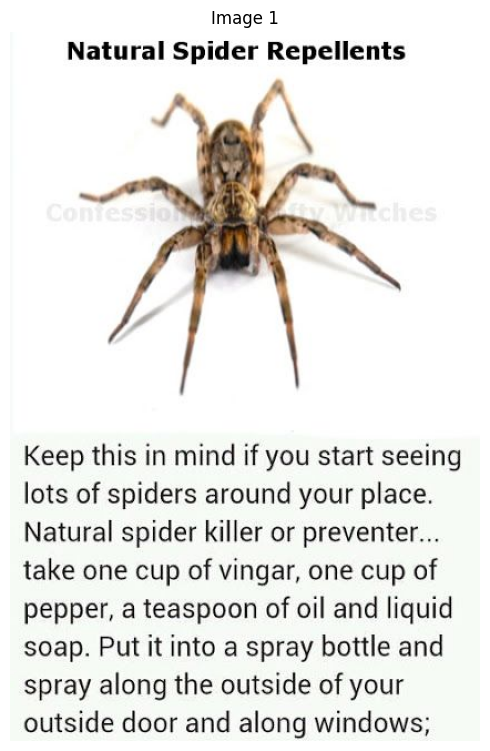

similar images


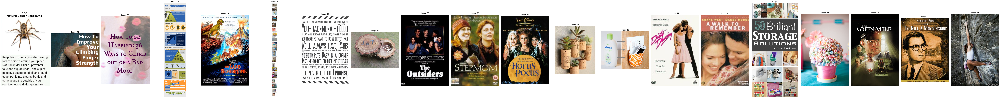

In [58]:
similar_to = 1
init_and_perform_knn(embeddings, similar_to, image_urls, n_neighbors=20, metric="cosine")

Distances: [[0.         0.33067262 0.3860246  0.39078218 0.42027926 0.4663025
  0.47843087 0.4864201  0.49064195 0.49615335 0.51360464 0.53245986
  0.53639084 0.5407319  0.5473944  0.54855144 0.5545722  0.5802535
  0.5812917  0.5865042 ]]
Indices: [[60 74 76 66 70 62 89 90 61 86 73 78 83 71 84 79 85 65 69 88]]
original image


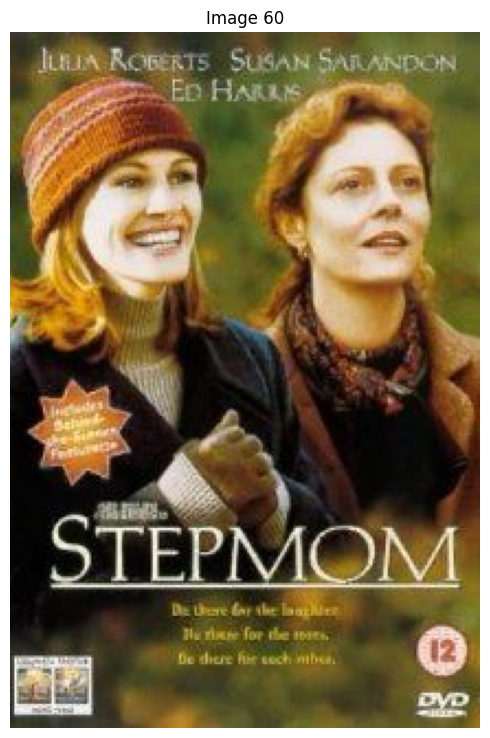

similar images


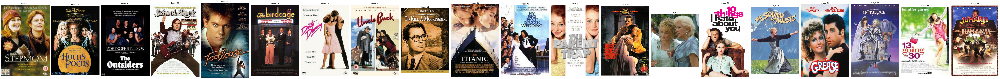

In [59]:
similar_to = 60
init_and_perform_knn(embeddings, similar_to, image_urls, n_neighbors=20, metric="cosine")

5. PCA

TLDR; 5 components seems like a good-ish choice (?), we probably need to do some variance though.

In [130]:
from sklearn.decomposition import PCA

pca = PCA(n_components=5)
reduced_embeddings = pca.fit_transform(embeddings)

Distances: [[0.         0.08651131 0.17401874 0.1918087  0.30164337 0.34547198
  0.38930923 0.39137596 0.43712288 0.4372341 ]]
Indices: [[ 1 97 17 93  5 96 60 99 67 71]]
original image


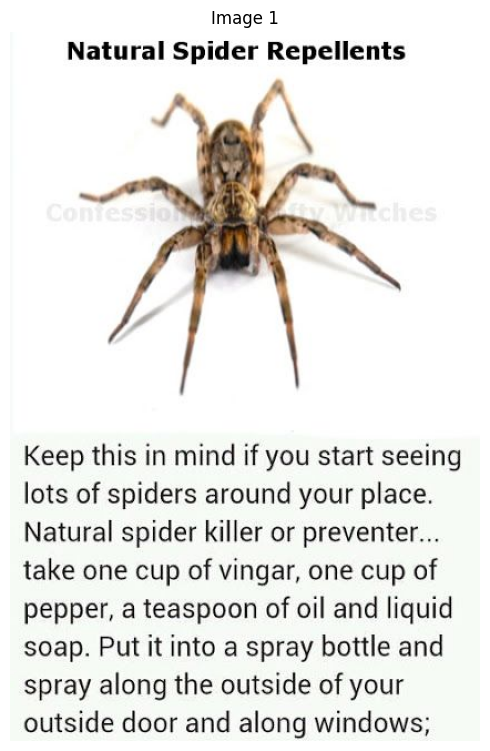

similar images


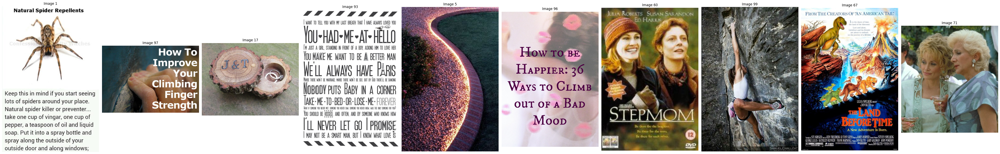

In [131]:
similar_to = 1
init_and_perform_knn(reduced_embeddings, similar_to, image_urls, n_neighbors=10, algorithm="auto")

In [42]:
def process_and_index_image(image_url):
    feature_vector = image_to_feature_vector(image_url)
    return feature_vector
    
    # # Assume you have a function to index this in Elasticsearch
    # index_image_features_in_es(image_url, feature_vector)